## **1) Author**

Student Name: PRAJWAL BHADRAVATHI NARAYANA MURTHY

Student ID - EC211218


## **2) Problem Formulation**

Audio classification can be referred to as the process of analyzing audio recordings and deriving the conclusions about the kind of audio we are processing. In this notebook we are classifying the audio recordings which takes **Potter** and **StarWars** audio segments as input and predicts the correct song label using a **Deep Learing MLP** model.


## **3) Pipeline** 

The proposed model in this notebook follows a end-to-end construct that orchestrates the flow of data, transformation and its output form along with a deep learning model. The below steps are followed in the notebook.

1.   Fetch raw audio data from QMUL shared drive link.
2.   Data preprocessing using pandas and creating a metadata.csv file which has labelled audio data for our model. 
3.   Extracting the features from audio recordings and considering them as predictors.
4.   Split the dataset for training and testing(validation).
4.   Create a ANN model which takes features and labelled input from previous steps.
5.   Train the model with the training dataset and validate the accuracy.
6.   Test the model with random samples and determine if the model is predicting the correct song as per the input.



 

## **4) Transformation Stage**

Transformation stage is one of the major part in our project. Since our dataset is related to audio signals, we need to extract features from audio samples and consider them as predictors for our model. 



In this notebook, **MFCC(Mel-frequency cepstral coefficients)** feature extraction technique is used to transform audio samples into a set of features based on the parameters. The extraction of this feature in this notebook have been implemented using **Librosa library**.

Reference used --

  

*   Mel-Frequency Cepstral Coefficients Explained Easily
    https://www.youtube.com/watch?v=4_SH2nfbQZ8

*   Extracting Mel-Frequency Cepstral Coefficients with Python
    https://www.youtube.com/watch?v=WJI-17MNpdE
  


## **5) Modelling**

Its always quite difficult to select a specific model for classification problems, especially when we are playing with audio datasets. Though there are good number of ML models like SVM, K-nearest, or Regression which I have implemented for sample dataset, I have considered to explore more options in **Deep Learning** to classify audio samples.

In this notebook, I have explored the classification of audio samples with **Artificial Neural Networks MLP** using **Keras** and **Tensorflow**.




## **6) Methodology**

Every model has its own way to get trained and validate it's accuracy. In this notebook, 80% of the dataset is being used to train the neural network. We will be using 100 epochs to iterate through out dataset with batch size 30.

**Accuracy** will be used as a metrics to evaluate how well the model can classify potter and starwars.

**Categorical_crossentropy** is used as loss function. If we get the low score, we can determine that the model is performing well.

To get the quick results and reduce losses, **Adam optimizer** is used in the model

Along with the above techniques, model will be validated manually using the sample audio files. After testing, a sample audio file will be fed to the neural network and it is expected to return the song name of the audio sample










## **7) Dataset**

The dataset from the audio classification have been extracted from QMUL's shared drive. The audio samples of both Potter and StarWars have been downloaded to the local machine for further preprocessing.
Overall, the dataset has **834** audio files. Although few files had discrepency in their naming conventions, I have considered all audio files to maintain consistency post file name cleansing. 

Further in the notebook, explaination about the **data preprocessing, visualization, feature extration** and **modelling** is done for each code cell.

**Importing initial libraries**

In [ ]:


import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

import os, sys, re, pickle, glob
import urllib.request
import zipfile

import IPython.display as ipd
from tqdm import tqdm
import librosa

Datasets are downloaded to local machine using the links provided and later preprocessed using Jupyter 

In [ ]:
#Access all audio files in local drive using glob
sample_path = 'D:/ML_Audio_Datasets/DataSets/*.wav'
files = glob.glob(sample_path)
print("The total number Potter and StarWars files downloaded and extracted are : ",len(files))

The total number Potter and StarWars files downloaded and extracted are :  834


In [ ]:
# To display 5 random audio files

for _ in range(5):
  n = np.random.randint(800)
  print(files[n].split('/')[-1].split('\\')[-1])
  display(ipd.Audio(files[n]))


S160_whistle_2_Potter.wav


S79_hum_1_[Potter].wav


S72_hum_2_Potter.wav


S115_whistle_2_StarWars.wav


S88_whistle_1_[potter].wav


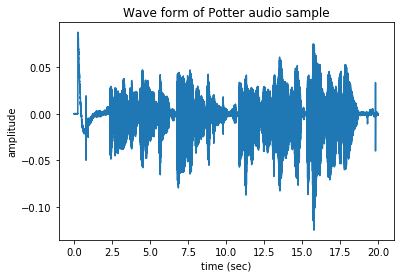

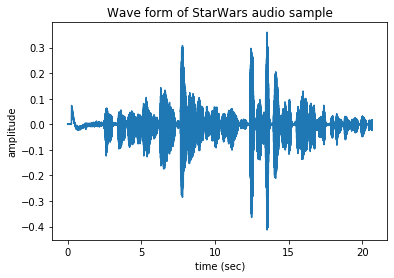

In [ ]:
##Visualizing the Potter and StarWars audio samples in wave form

n=0
#fs = None # Sampling frequency. If None, fs would be 22050
x, fs = librosa.load(files[n])
t = np.arange(len(x))/fs
plt.plot(t,x)
plt.xlabel('time (sec)')
plt.ylabel('amplitude')
plt.title('Wave form of Potter audio sample')
plt.show()
display(ipd.Audio(files[n]))


n=2
#fs = None # Sampling frequency. If None, fs would be 22050
x, fs = librosa.load(files[n])
t = np.arange(len(x))/fs
plt.plot(t,x)
plt.xlabel('time (sec)')
plt.ylabel('amplitude')
plt.title('Wave form of StarWars audio sample')
plt.show()
display(ipd.Audio(files[n]))

Original sample rate: 44100
Librosa sample rate: 22050


Text(0.5, 1.0, 'Librosa with 1 channel')

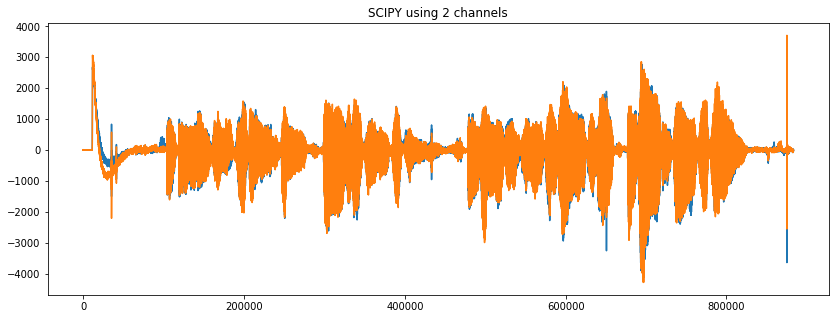

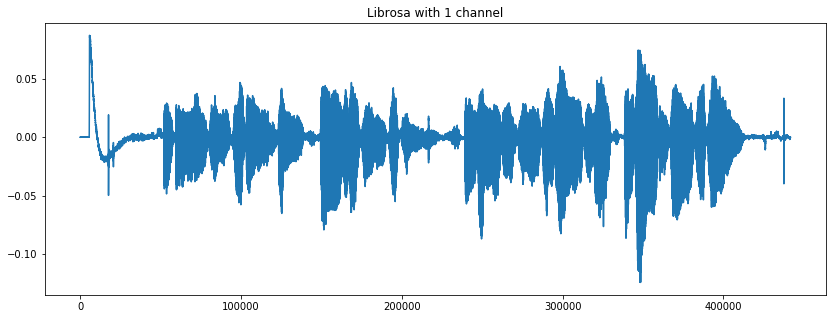

In [ ]:
## There are two libraries to play with audio datasets, librosa and scipy. 
## However, I have used Librosa in the notebook because of its powerful features

from scipy.io import wavfile as wav
import numpy as np

filename = files[0]

librosa_audio, librosa_sample_rate = librosa.load(filename) 
scipy_sample_rate, scipy_audio = wav.read(filename)

##Librosa load function converts the SR to 22.05 KHz
print('Original sample rate:', scipy_sample_rate) 
print('Librosa sample rate:', librosa_sample_rate) 

## librosa will convert the signals to mono, whereas the scipy.io consist of dual channels

## plotting librosa_audio values and scipy_audio values 
plt.figure(figsize=(14, 5))
plt.plot(scipy_audio)
plt.title('SCIPY using 2 channels')

## librosa with mono channel
plt.figure(figsize=(14, 5))
plt.plot(librosa_audio)
plt.title('Librosa with 1 channel')


Creating a metadata.csv file to have uniformity in filename and create a labelled dataframe

In [ ]:
# fetching the file names of all audio samples and extracting it to csv file for further preprocessing
temp_files=[]
for fille in files:
  temp_files.append(fille.split('/')[-1].split('\\')[-1])

temp_file_df = pd.DataFrame(temp_files)
temp_file_df.to_csv('MLEndHW.csv')

In [ ]:
## Post file name cleansing locally, a new csv file is fetched back to notebook with labelling

metadata = pd.read_csv("D:/ML_Audio_Datasets/MLEndHW_Metadata_Basic.csv")
metadata.head()

,File_ID,Participant,Interpretation,Interpretation Number,Song,Class
0,S1_hum_2_Potter.wav,S1,hum,2,Potter.wav,Potter.wav
1,S1_whistle_2_Potter.wav,S1,whistle,2,Potter.wav,Potter.wav
2,S2_hum_2_Potter.wav,S2,hum,2,Potter.wav,Potter.wav
3,S2_whistle_2_Potter.wav,S2,whistle,2,Potter.wav,Potter.wav
4,S3_hum_1_Potter.wav,S3,hum,1,Potter.wav,Potter.wav


In [ ]:
# A column called class has been added which will be used as label for our ANN
print('The two unique class lables are --> ') 
print(str(metadata['Class'].unique()))

The two unique class lables are --> 
['Potter.wav' 'StarWars.wav']


# 8)  Results

One of the major part of the project here is to extract features from audio samples. The below function is written to fetch the Mel-Frequency Cepstral Coefficients (MFCC) features for each of the audio files provided using Librosa's mfcc() function

In [ ]:
def MFCC_features_extractor(file):
    audio_data, sample_rate = librosa.load(file, res_type='kaiser_fast')
    mfccs_features = librosa.feature.mfcc(y=audio_data, sr=sample_rate, n_mfcc=40)
    mfccs_scaling_feat = np.mean(mfccs_features.T,axis=0)
    return mfccs_scaling_feat

In [ ]:
path_data = "D:/ML_Audio_Datasets/DataSets/"

import numpy as np
extracted_features=[]
for index_num,row in tqdm(metadata.iterrows()):
    file_name = os.path.join(os.path.abspath(path_data), str(row["File_ID"]))
    final_class_labels=row["Class"]
    data=MFCC_features_extractor(file_name)
    extracted_features.append([data,final_class_labels])

824it [05:33,  2.47it/s]


Post feature extraction of each of the audio files, the values have been appended to table extracted_features. 

In [ ]:
# Creating a dataframe for extracted_features

extracted_feature_df = pd.DataFrame(extracted_features, columns=['feature','class'])
print("40 coefficients are extracted for each of the audio sample")
extracted_feature_df.head()

##Class represents the label of the audio file i,e the song

40 coefficients are extracted for each of the audio sample


,feature,class
0,"[-570.35205, 165.22372, 11.892204, 28.463907, ...",Potter.wav
1,"[-559.3699, 109.55884, -44.326736, 30.62622, 1...",Potter.wav
2,"[-661.8449, 108.69146, 45.1546, 38.126183, 11....",Potter.wav
3,"[-692.88226, 68.7736, -20.890484, 8.210867, 21...",Potter.wav
4,"[-346.79388, 136.5315, -0.27057907, 28.94037, ...",Potter.wav


Creating dependent and independent variables 

In [ ]:
## X represents the predictors 
X = np.array(extracted_feature_df['feature'].tolist())

## y represents the class labels
y=np.array(extracted_feature_df['class'].tolist())


In [ ]:
X.shape
print('Total number of samples considered',X.shape[0])
print('Total number of features extracted using MFCC are -',X.shape[1])

Total number of samples considered 824
Total number of features extracted using MFCC are - 40


In [ ]:
y.shape

(824,)

Post feature extraction and classification of predictors and labels, the next steps in the notebook presents the ANN model creation using Keras and Tensoflow, training of the model, accuracy checks and validation

In [ ]:
## importing necessary tensorflow, keras libraries
import tensorflow as tf
from tensorflow.keras.utils import to_categorical
from sklearn.preprocessing import LabelEncoder

Since the class values in 'y' are categorical text data, LabelEncoder is used to encode the categorical text data into numerical data

In [ ]:
labelencoder = LabelEncoder()
y=to_categorical(labelencoder.fit_transform(y))

In [ ]:
print("After label encoding the representation of y is : \n\n",y)

After label encoding the representation of y is : 

 [[1. 0.]
 [1. 0.]
 [1. 0.]
 ...
 [0. 1.]
 [0. 1.]
 [0. 1.]]


To split the dataset, sklearn.model_selection.train_test_split is used. The testing size is 20%

In [ ]:
from sklearn.model_selection import train_test_split
X_train,X_test,y_train,y_test=train_test_split(X,y,test_size=0.2,random_state=0)

In [ ]:
print(" Number of samples considered for Training :",X_train.shape[0])
print(" Number of samples considered for Testing :",X_test.shape[0])

 Number of samples considered for Training : 659
 Number of samples considered for Testing : 165


In [ ]:
number_of_classes = y.shape[1]
print('Number of classes in our dataset is :',number_of_classes)

Number of classes in our dataset is : 2


Model building

In [ ]:
## Importing necessary libraries
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense,Dropout,Activation,Flatten
from tensorflow.keras.optimizers import Adam
from sklearn import metrics
from tensorflow.keras.layers import Convolution2D, MaxPooling2D
from sklearn import metrics 

Using a Sequential model to build our neural network

We will build model comprising of 4 layers


    An Input layer - receives input shape of (40,) since each audio has 40 MFCC columns with 150 nodes
    
    
    Two hidden layers - with nodes 250 and 150 using Rectified Linear Activation
    
    
    An output layer - Output layer has 2 nodes, i,e our number of classes. Softmax is used as activation for output layer
    


To avoid overfitting of training data, Dropout value of 19% is considered for our first 3 layers
    

In [ ]:
audio_model=Sequential()
###Input layer
audio_model.add(Dense(150,input_shape=(40,)))
audio_model.add(Activation('relu'))
audio_model.add(Dropout(0.19))
###second layer
audio_model.add(Dense(250))
audio_model.add(Activation('relu'))
audio_model.add(Dropout(0.19))
###third layer
audio_model.add(Dense(150))
audio_model.add(Activation('relu'))
audio_model.add(Dropout(0.19))

###Output layer
audio_model.add(Dense(number_of_classes))
audio_model.add(Activation('softmax'))

In [ ]:
print('The model architecture is shown as below \n')
audio_model.summary()

The model architecture is shown as below 

Model: "sequential_10"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_38 (Dense)             (None, 150)               6150      
_________________________________________________________________
activation_38 (Activation)   (None, 150)               0         
_________________________________________________________________
dropout_27 (Dropout)         (None, 150)               0         
_________________________________________________________________
dense_39 (Dense)             (None, 250)               37750     
_________________________________________________________________
activation_39 (Activation)   (None, 250)               0         
_________________________________________________________________
dropout_28 (Dropout)         (None, 250)               0         
_________________________________________________________________
dense_40 (

In [ ]:
## To compile the model, below three paramaters are used
audio_model.compile(loss='categorical_crossentropy',metrics=['accuracy'],optimizer='adam')

# Training the model 

The model gets trained with 100 epoches with batch size 30

In [ ]:
from tensorflow.keras.callbacks import ModelCheckpoint
from datetime import datetime 

num_epochs = 100
num_batch_size = 30

checkpointer = ModelCheckpoint(filepath='D:/ML_Audio_Datasets/PottervsStarWars_classification.hdf5',verbose=1, save_best_only=True)
start = datetime.now()

history_with_dropout = audio_model.fit(X_train, y_train, batch_size=num_batch_size, epochs=num_epochs, validation_data=(X_test, y_test), callbacks=[checkpointer], verbose=1)


duration = datetime.now() - start
print("Training completed in time: ", duration)

Train on 659 samples, validate on 165 samples
Epoch 1/100
420/659 [==================>...........] - ETA: 5s - loss: 26.0153 - acc: 0.53 - ETA: 0s - loss: 11.7105 - acc: 0.4762
Epoch 00001: val_loss improved from inf to 3.11489, saving model to D:/ML_Audio_Datasets/PottervsStarWars_classification.hdf5
659/659 [==============================] - 1s 2ms/sample - loss: 9.3086 - acc: 0.4856 - val_loss: 3.1149 - val_acc: 0.5091
Epoch 2/100
420/659 [==================>...........] - ETA: 0s - loss: 5.2852 - acc: 0.366 - ETA: 0s - loss: 3.6721 - acc: 0.5548
Epoch 00002: val_loss improved from 3.11489 to 0.67558, saving model to D:/ML_Audio_Datasets/PottervsStarWars_classification.hdf5
659/659 [==============================] - 0s 261us/sample - loss: 3.3098 - acc: 0.5432 - val_loss: 0.6756 - val_acc: 0.6970
Epoch 3/100
330/659 [==============>...............] - ETA: 0s - loss: 2.8272 - acc: 0.433 - ETA: 0s - loss: 2.1601 - acc: 0.5212
Epoch 00003: val_loss did not improve from 0.67558
659/659 

360/659 [===============>..............] - ETA: 0s - loss: 0.7084 - acc: 0.500 - ETA: 0s - loss: 0.6735 - acc: 0.5806
Epoch 00052: val_loss did not improve from 0.63085
659/659 [==============================] - 0s 190us/sample - loss: 0.6607 - acc: 0.5766 - val_loss: 0.6383 - val_acc: 0.7030
Epoch 53/100
420/659 [==================>...........] - ETA: 0s - loss: 0.7043 - acc: 0.533 - ETA: 0s - loss: 0.6571 - acc: 0.5905
Epoch 00053: val_loss improved from 0.63085 to 0.62260, saving model to D:/ML_Audio_Datasets/PottervsStarWars_classification.hdf5
659/659 [==============================] - 0s 261us/sample - loss: 0.6485 - acc: 0.6115 - val_loss: 0.6226 - val_acc: 0.7273
Epoch 54/100
480/659 [====================>.........] - ETA: 0s - loss: 0.7363 - acc: 0.533 - ETA: 0s - loss: 0.6732 - acc: 0.5854
Epoch 00054: val_loss improved from 0.62260 to 0.61262, saving model to D:/ML_Audio_Datasets/PottervsStarWars_classification.hdf5
659/659 [==============================] - 0s 237us/sample 

**Testing of the model**

In [ ]:
train_accuracy=audio_model.evaluate(X_train,y_train,verbose=0)
print('Training accuracy using ANN is', train_accuracy[1]*100)

Training accuracy using ANN is 72.07890748977661


In [ ]:
test_accuracy=audio_model.evaluate(X_test,y_test,verbose=0)
print('Validation accuracy using ANN is ', test_accuracy[1]*100)

Validation accuracy using ANN is  68.48484873771667


The initial model had suffered from overfitting. However, as stated above adding of **dropout value of 19%** helped in model not to overfit and resulted in **~68% Validation accuracy** and **~72% Training accuracy**

**Visualizing the Learning curve and accuracy**

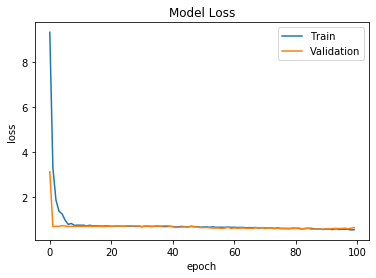

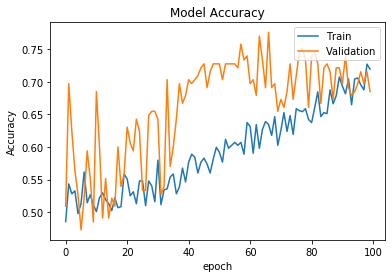

In [ ]:
## plotting training and validation loss values of a network
import matplotlib.pyplot as plt
plt.plot(history_with_dropout.history['loss'])
plt.plot(history_with_dropout.history['val_loss'])
plt.title('Model Loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['Train','Validation'],loc='upper right')
plt.show()

##plotting model accuracy
plt.plot(history_with_dropout.history['acc'])
plt.plot(history_with_dropout.history['val_acc'])
plt.title('Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('epoch')
plt.legend(['Train','Validation'],loc='upper right')
plt.show()

**Validation of the model--**

For validation, I have taken random audio samples from the dataset and feeding the samples to neural network for prediction

In [ ]:
## Validation 1 - Providing potter sample to trained neural network to check if its predicting the song as per input

print('Validation testing number 1 \nThe given audio sample is from Potter\n')
filename="C:/Users/Admin/Desktop/ML Recordings/Potter/hum_1_Potter.wav"
mfccs_scaled_features = MFCC_features_extractor(filename)
print('Extracting features from sample audio\n')
mfccs_scaled_features=mfccs_scaled_features.reshape(1,-1)
print(mfccs_scaled_features)
print('\nSample audio fed to trained model')
predicted_label=audio_model.predict_classes(mfccs_scaled_features)
prediction_class = labelencoder.inverse_transform(predicted_label) 
print('The model predicted that the audio sample is from song::',prediction_class[0].split('.')[0])

print('---------------------------------------------------------------------------------------------\n')

## Validation 2 - Providing StarWars sample to trained neural network to check if its predicting the song as per input

print('Validation testing number 2 \nThe given audio sample is from StarWars\n')
filename="C:/Users/Admin/Desktop/ML Recordings/StarWars/hum_3_StarWars.wav"
mfccs_scaled_features = MFCC_features_extractor(filename)
print('Extracting features from sample audio\n')
mfccs_scaled_features=mfccs_scaled_features.reshape(1,-1)
print(mfccs_scaled_features)
print('\nSample audio fed to trained model')
predicted_label=audio_model.predict_classes(mfccs_scaled_features)
prediction_class = labelencoder.inverse_transform(predicted_label) 
print('The model predicted that the audio sample is from song::',prediction_class[0].split('.')[0])

print('---------------------------------------------------------------------------------------------\n')
## Validation 3 - Providing Potter whistle sample to trained neural network to check if its predicting the song as per input

print('Validation testing number 3 \nValidating with Potter whistle sample \nThe given audio sample is a whistle sample from Potter\n')
filename="D:/ML_Audio_Datasets/DataSets/S93_whistle_2_Potter.wav"
mfccs_scaled_features = MFCC_features_extractor(filename)
print('Extracting features from sample audio\n')
mfccs_scaled_features=mfccs_scaled_features.reshape(1,-1)
print(mfccs_scaled_features)
print('\nSample audio fed to trained model')
predicted_label=audio_model.predict_classes(mfccs_scaled_features)
prediction_class = labelencoder.inverse_transform(predicted_label) 
print('The model predicted that the audio sample is from song::',prediction_class[0].split('.')[0])

print('---------------------------------------------------------------------------------------------\n')

## Validation 4 - Providing StarWars whistle sample to trained neural network to check if its predicting the song as per input

print('Validation testing number 4 \nValidating with StarWars whistle sample \nThe given audio sample is a whistle sample from StarWars\n')
filename="D:/ML_Audio_Datasets/DataSets/S95_Whistle 1 StarWars.wav"
mfccs_scaled_features = MFCC_features_extractor(filename)
print('Extracting features from sample audio\n')
mfccs_scaled_features=mfccs_scaled_features.reshape(1,-1)
print(mfccs_scaled_features)
print('\nSample audio fed to trained model')
predicted_label=audio_model.predict_classes(mfccs_scaled_features)
prediction_class = labelencoder.inverse_transform(predicted_label) 
print('The model predicted that the audio sample is from song::',prediction_class[0].split('.')[0])


Validation testing number 1 
The given audio sample is from Potter

Extracting features from sample audio

[[-5.6430927e+02  1.2993810e+02 -2.5563183e+01  1.1118282e+01
   1.9756449e+01 -4.9024482e+00  9.7584171e+00 -4.2412205e+00
  -2.5730791e+01 -2.9786057e+00  7.9315205e+00 -3.9548295e+00
  -3.6894502e-03 -4.3071289e+00 -1.3820281e+01 -6.5507922e+00
  -2.4860022e+00 -6.9853883e+00 -9.8451405e+00 -1.1222998e+01
  -1.2053745e+01 -9.5964823e+00 -6.9778085e+00 -7.6495295e+00
  -7.7090111e+00 -3.5898778e+00  5.7998985e-01  9.1834289e-01
   2.4573977e+00  3.3095806e+00  1.0157892e+00  4.5418036e-01
   1.7290375e+00  5.9511560e-01 -1.0970763e+00  3.1455297e+00
   5.2948060e+00  1.9325125e+00  6.9461900e-01  1.6301459e+00]]

Sample audio fed to trained model
The model predicted that the audio sample is from song:: Potter
---------------------------------------------------------------------------------------------

Validation testing number 2 
The given audio sample is from StarWars

Extract

# 9) Conclusion



Initially, a model was developed without a dropout layer. As expected, model was overfitted with good training accuracy but very low validation accuracy


Training accuracy without dropout layer in ANN is 98.48254919052124
Validation accuracy without dropout layer using ANN is 66.66666865348816


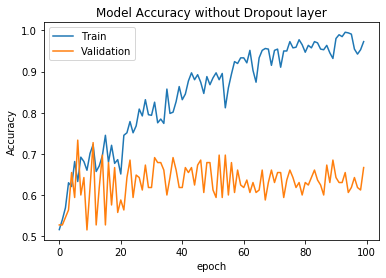

------------------------------------------------------
Training accuracy with Dropout layer using ANN is 72.07890748977661
Validation accuracy with Dropout using ANN is  68.48484873771667


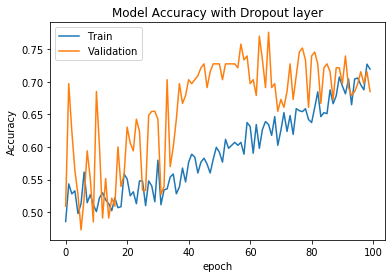

In [ ]:


train_accuracy=aud_model.evaluate(X_train,y_train,verbose=0)
print('Training accuracy without dropout layer in ANN is', train_accuracy[1]*100)

test_accuracy=aud_model.evaluate(X_test,y_test,verbose=0)
print('Validation accuracy without dropout layer using ANN is', test_accuracy[1]*100)


## Accuracy comaprison with and without dropout layer
plt.plot(history.history['acc'])
plt.plot(history.history['val_acc'])
plt.title('Model Accuracy without Dropout layer')
plt.ylabel('Accuracy')
plt.xlabel('epoch')
plt.legend(['Train','Validation'],loc='upper left')
plt.show()


print('------------------------------------------------------')

train_accuracy=audio_model.evaluate(X_train,y_train,verbose=0)
print('Training accuracy with Dropout layer using ANN is', train_accuracy[1]*100)

test_accuracy=audio_model.evaluate(X_test,y_test,verbose=0)
print('Validation accuracy with Dropout using ANN is ', test_accuracy[1]*100)


plt.plot(history_with_dropout.history['acc'])
plt.plot(history_with_dropout.history['val_acc'])
plt.title('Model Accuracy with Dropout layer')
plt.ylabel('Accuracy')
plt.xlabel('epoch')
plt.legend(['Train','Validation'],loc='upper left')
plt.show()

Clearly we could see that including dropout layer helped in reducing the overfitting of model. During validation, when testing the neural network with both hum and whistle sample of potter and starwars, the model predicted the labels correctly.The validation accuracy of 68% is a good score to predict a random audio sample to its specific song. However, the networks can be further tuned in the future using CNN and by fetching other advanced audio features. 


With Deep Learning evolving rapidly in all the fields including Audio/Video industry MLP, CNN, RNN netowrks will be of great use in classification of Audio Samples.


# References

1) Speech Recognition — Feature Extraction MFCC & PLP - https://jonathan-hui.medium.com/speech-recognition-feature-extraction-mfcc-plp-5455f5a69dd9


2) MFCC Technique for Speech Recognition - https://www.analyticsvidhya.com/blog/2021/06/mfcc-technique-for-speech-recognition/


3) Extracting Mel-Frequency Cepstral Coefficients with Python- https://www.youtube.com/watch?v=WJI-17MNpdE


4) Speech Recognition using Neural Network (with MFCC Feature Extraction) - https://www.youtube.com/watch?v=dUmSHIduo3c
